## Graphing network packets

This notebook currently relies on HoloViews 1.9 or above. Run `conda install holoviews` to install it.

## Preparing data

The data source comes from a publicly available network forensics repository: http://www.netresec.com/?page=PcapFiles. The selected file is https://download.netresec.com/pcap/maccdc-2012/maccdc2012_00000.pcap.gz.

```
tcpdump -qns 0 -r maccdc2012_00000.pcap | grep tcp > maccdc2012_00000.txt
```

For example, here is a snapshot of the resulting output:

```
09:30:07.780000 IP 192.168.202.68.8080 > 192.168.24.100.1038: tcp 1380
09:30:07.780000 IP 192.168.24.100.1038 > 192.168.202.68.8080: tcp 0
09:30:07.780000 IP 192.168.202.68.8080 > 192.168.24.100.1038: tcp 1380
09:30:07.780000 IP 192.168.202.68.8080 > 192.168.24.100.1038: tcp 1380
09:30:07.780000 IP 192.168.27.100.37877 > 192.168.204.45.41936: tcp 0
09:30:07.780000 IP 192.168.24.100.1038 > 192.168.202.68.8080: tcp 0
09:30:07.780000 IP 192.168.202.68.8080 > 192.168.24.100.1038: tcp 1380
09:30:07.780000 IP 192.168.202.68.8080 > 192.168.24.100.1038: tcp 1380
09:30:07.780000 IP 192.168.202.68.8080 > 192.168.24.100.1038: tcp 1380
09:30:07.780000 IP 192.168.202.68.8080 > 192.168.24.100.1038: tcp 1380
```

Given the directional nature of network traffic and the numerous ports per node, we will simplify the graph by treating traffic between nodes as undirected and ignorning the distinction between ports. The graph edges will have weights represented by the total number of bytes across both nodes in either direction.

```
python pcap_to_parquet.py maccdc2012_00000.txt
```

The resulting output will be two Parquet dataframes, `maccdc2012_nodes.parq` and `maccdc2012_edges.parq`.

**NOTE**: For your convenience this last step is captured in the `anaconda-project run prepare_data` command.

## Loading data

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
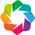

In [1]:
import holoviews as hv
from holoviews import opts, dim
import networkx as nx
import dask.dataframe as dd

from holoviews.operation.datashader import (
    datashade, dynspread, directly_connect_edges, bundle_graph, stack
)
from holoviews.element.graphs import layout_nodes
from datashader.layout import random_layout
from colorcet import fire

hv.extension('bokeh')

keywords = dict(bgcolor='black', width=800, height=800, xaxis=None, yaxis=None)
opts.defaults(opts.Graph(**keywords), opts.Nodes(**keywords), opts.RGB(**keywords))

In [2]:
edges_df = dd.read_parquet('./data/maccdc2012_full_edges.parq').compute()
edges_df = edges_df.reset_index(drop=True)
graph = hv.Graph(edges_df)
len(edges_df)

21759

## Edge bundling & layouts

Datashader and HoloViews provide support for a number of different graph layouts including circular, force atlas and random layouts. Since large graphs with thousands of edges can become quite messy when plotted datashader also provides functionality to bundle the edges.

#### Circular layout

By default the HoloViews Graph object lays out nodes using a circular layout. Once we have declared the ``Graph`` object we can simply apply the ``bundle_graph`` operation. We also overlay the datashaded graph with the nodes, letting us identify each node by hovering.

In [3]:
opts.defaults(opts.Nodes(size=5, padding=0.1))

In [4]:
circular = bundle_graph(graph)
datashade(circular, width=800, height=800) * circular.nodes

:DynamicMap   []
   :Overlay
      .RGB.I   :RGB   [x,y]   (R,G,B,A)
      .Nodes.I :Nodes   [x,y,index]

#### Force Atlas 2 layout

For other graph layouts you can use the ``layout_nodes`` operation supplying the datashader or NetworkX layout function. Here we will use the ``nx.spring_layout`` function based on the [Fruchterman-Reingold](https://en.wikipedia.org/wiki/Force-directed_graph_drawing) algorithm. Instead of bundling the edges we may also use the directly_connect_edges function:

In [5]:
forceatlas = directly_connect_edges(layout_nodes(graph, layout=nx.spring_layout))
datashade(forceatlas, width=800, height=800) * forceatlas.nodes

:DynamicMap   []
   :Overlay
      .RGB.I   :RGB   [x,y]   (R,G,B,A)
      .Nodes.I :Nodes   [x,y,index]

#### Random layout

Datashader also provides a number of layout functions in case you don't want to depend on NetworkX:

In [6]:
random = bundle_graph(layout_nodes(graph, layout=random_layout))
datashade(random, width=800, height=800) * random.nodes

:DynamicMap   []
   :Overlay
      .RGB.I   :RGB   [x,y]   (R,G,B,A)
      .Nodes.I :Nodes   [x,y,index]

## Showing nodes with active traffic

To select just nodes with active traffic we will split the dataframe of bundled paths and then apply ``select`` on the new Graph to select just those edges with a weight of more than 10,000. By overlaying the sub-graph of high traffic edges we can take advantage of the interactive hover and tap features that bokeh provides while still revealing the full datashaded graph in the background.

In [7]:
overlay = datashade(circular, width=800, height=800) * circular.select(weight=(10000, None))
overlay.opts(
    opts.Graph(edge_line_color='white', edge_hover_line_color='blue', padding=0.1))

:DynamicMap   []
   :Overlay
      .RGB.I   :RGB   [x,y]   (R,G,B,A)
      .Graph.I :Graph   [source,target]   (protocol,weight)

## Highlight TCP and UDP traffic

Using the same selection features we can highlight TCP and UDP connections separately again by overlaying it on top of the full datashaded graph. The edges can be revealed over the highlighted nodes and by setting an alpha level we can also reveal connections with both TCP (blue) and UDP (red) connections in purple.

In [8]:
udp_opts = opts.Graph(edge_hover_line_color='red', node_size=20, 
                      node_fill_color='red', edge_selection_line_color='red')
tcp_opts = opts.Graph(edge_hover_line_color='blue', 
                      node_fill_color='blue', edge_selection_line_color='blue')

udp = forceatlas.select(protocol='udp', weight=(10000, None)).opts(udp_opts)
tcp = forceatlas.select(protocol='icmp', weight=(10000, None)).opts(tcp_opts)
layout = datashade(forceatlas, width=800, height=800, normalization='log', cmap=['black', 'white']) * tcp * udp

layout.opts(
    opts.Graph(edge_alpha=0, edge_hover_alpha=0.5, edge_nonselection_alpha=0, inspection_policy='edges',
               node_size=8, node_alpha=0.5, edge_color=dim('weight')))

:DynamicMap   []
   :Overlay
      .RGB.I    :RGB   [x,y]   (R,G,B,A)
      .Graph.I  :Graph   [source,target]   (protocol,weight)
      .Graph.II :Graph   [source,target]   (protocol,weight)

## Coloring by protocol

As we have already seen we can easily apply selection to the ``Graph`` objects. We can use this functionality to select by protocol, datashade the subgraph for each protocol and assign each a different color and finally stack the resulting datashaded layers:

In [9]:
from bokeh.palettes import Blues9, Reds9, Greens9
ranges = dict(x_range=(-.5, 1.6), y_range=(-.5, 1.6), width=800, height=800)
protocols = [('tcp', Blues9), ('udp', Reds9), ('icmp', Greens9)]
shaded = hv.Overlay([datashade(forceatlas.select(protocol=p), cmap=cmap, **ranges)
                     for p, cmap in protocols]).collate()
stack(shaded * dynspread(datashade(forceatlas.nodes, cmap=['white'], **ranges)), link_inputs=True)

:DynamicMap   []
   :RGB   [x,y]   (R,G,B,A)

## Selecting the highest targets

With a bit of help from pandas we can also extract the twenty most targetted nodes and overlay them on top of the datashaded plot:

In [10]:
target_counts = list(edges_df.groupby('target').count().sort_values('weight').iloc[-20:].index.values)
overlay = (datashade(forceatlas, cmap=fire[128:]) * 
           datashade(forceatlas.nodes, cmap=['cyan']) *
           forceatlas.nodes.select(index=target_counts))

overlay.opts( opts.Nodes(size=8), opts.RGB(width=800, height=800))

:DynamicMap   []
   :Overlay
      .RGB.I   :RGB   [x,y]   (R,G,B,A)
      .RGB.II  :RGB   [x,y]   (R,G,B,A)
      .Nodes.I :Nodes   [x,y,index]